# HSLU Seminarwoche, Teil 1 – Space Syntax

## 0. Tooling Setup

Before we get started go through the following setup to get a basic working system or adapt where you like to use different tools.

```sh
# Download this repo
git clone git@github.com:cividi/hslu-seminarwoche.git
cd hslu-seminarwoche

# Create and set mapbox token in .env file
touch .env
echo 'MAPBOX_TOKEN=<TOKEN>' > .env

# Download the CLI binary from https://github.com/SpaceGroupUCL/depthmapX/releases for your operating system. Place it in this folder
wget https://github.com/SpaceGroupUCL/depthmapX/releases/download/v0.8.0/depthmapXcli_macos # for macOS
chmod +x ./depthmapX_macos # for macOS, to accept the gate keeper: right-click -> open and confirm opening

# If you don't have poetry installed install it via
curl -sSL https://raw.githubusercontent.com/python-poetry/poetry/master/get-poetry.py | python - # macOS

(Invoke-WebRequest -Uri https://raw.githubusercontent.com/python-poetry/poetry/master/get-poetry.py -UseBasicParsing).Content | python - # Windows Powershell

# Once installed, configure and activate the virtual environment
poetry update && poetry shell # OR: make up

# Open the environment in your favorite editor, e.g. Visual Studio Code (https://code.visualstudio.com/) with
code .
```

In [3]:
# Import needed libraries

import geopandas as gpd
import pandas as pd
import osmnx as ox
from IPython.display import IFrame
%matplotlib inline
ox.config(log_console=True)

import space_syntax_utils as ssu
from shapely.geometry import Point, LineString
import folium

from dotenv import load_dotenv

load_dotenv()
mapbox_token = os.getenv('MAPBOX_TOKEN')

## 1. A simple street network

To get started we load and visualize a simple steet Network.

We will be using OSMnx to download a street network from OpenStreet Map and QGIS tools to clean and prepare it for a Space Syntax analysis.

### Requesting and plotting the street network for driving

In [5]:
G = ox.graph_from_address("Zentralstrasse 9, 6002 Luzern, Switzerland", dist=1000, network_type='walk')

# Optimizing the graph for walking intersections
G2 = ox.consolidate_intersections(ox.project_graph(G), rebuild_graph=True, tolerance=2.5, dead_ends=False)
G2 = ox.project_graph(G2, to_crs="EPSG:4326")
ox.plot_graph_folium(G2, popup_attribute='name', weight=2, color='#8b0000')

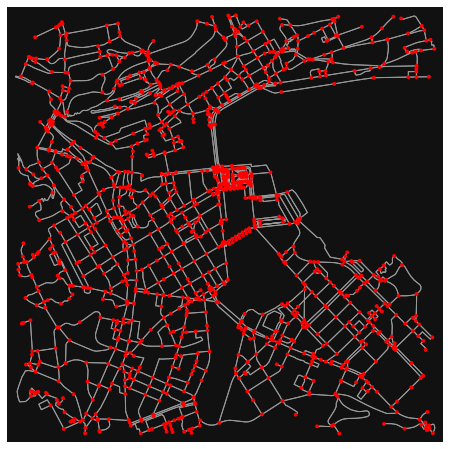

In [18]:
fig, ax = ox.plot_graph(G2, node_color='r')

## Running Space Syntax Analysis

In [6]:
file_name = 'lucerne_small'
ox.save_graph_geopackage(G2, filepath='./data/%s.gpkg' % (file_name))
ssu.gpkg_to_dxf('data/lucerne_small.gpkg', 'data/%s.dxf' % (file_name))
ssu.run_segment_analysis('data/lucerne_small.dxf', 'data/%s.graph' % (file_name))

converting data/lucerne_small.gpkg to data/lucerne_small.dxf...
importing data/lucerne_small.dxf...
converting data/lucerne_small.dxf to segment map...
calculating 500m, 1km, 2.5km and 5km angular segment analysis...


Open resulting .graph analysis file for preview.

## 2. Detecting local clusters in the region

As a definition for the "urban" region of Lucerne we are using the official ARE (Federal Office for Spatial Development) definition to include all Gemeinden around Lucerne that are Big centers (Lucerne and Küssnacht), it's adjacent secodondary centers and crown of big centers municipalities as published on [map.geo.admin.ch](https://s.geo.admin.ch/8eadc577c5).

In [6]:
# Urban Lucerne: https://s.geo.admin.ch/8eadc577c5

urbanes_luzern = [
    'Luzern, Switzerland',
    'Emmen, Switzerland',
    'Ebikon, Switzerland', 
    'Kriens, Switzerland',
    'Horw, Switzerland',
    'Emmenbrücke, Switzerland',
    'Adligenswil, Switzerland',
    'Meggen, Switzerland',
    'Rothenburg, Switzerland',
    'Hergiswil (NW), Switzerland',
    'Küssnacht (SZ), Switzerland',
    'Horw, Switzerland',
    'Udligenswil, Switzerland',
    'Root, Switzerland',
    'Gisikon, Switzerland',
    'Honau, Switzerland',
    'Buchrain, Switzerland',
    'Dierikon, Switzerland',
]

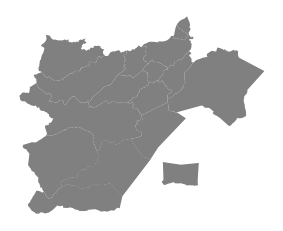

In [7]:
# get outline for urban municipalities around lucerne 
city = ox.geocode_to_gdf(urbanes_luzern)
city_proj = ox.project_gdf(city)
ax = city_proj.plot(fc='gray', ec='none')
_ = ax.axis('off')

In [8]:
# Load pre calculated dataset for the region
df = pd.read_csv('data/lucerne.csv')

# Extract only the 500m radius
df = df[["x1","y1","x2","y2","T1024 Integration R500 metric","T1024 Choice R500 metric"]]
df[["T1024 Integration R500 metric","T1024 Choice R500 metric"]].describe()

,T1024 Integration R500 metric,T1024 Choice R500 metric
count,84835.000000,84835.000000
mean,64.388314,3402.797725
std,40.851494,4728.920299
min,2.414644,0.000000
25%,35.362369,762.000000
50%,53.868610,1791.000000
75%,82.935367,4041.000000
max,316.860050,79627.000000


<AxesSubplot:>

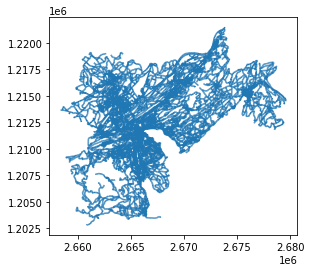

In [9]:
df["geometry"] = df[["x1","y1","x2","y2"]].apply(lambda r: LineString([Point(r.x1, r.y1), Point(r.x2, r.y2)]),axis=1)
gdf = gpd.GeoDataFrame(df.drop(columns=["x1","y1","x2","y2"]))
gdf.plot()

<AxesSubplot:ylabel='Frequency'>

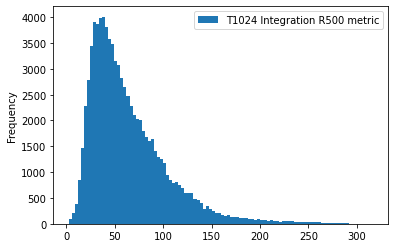

In [10]:
gdf[["T1024 Integration R500 metric"]].plot.hist(bins=100)

<AxesSubplot:>

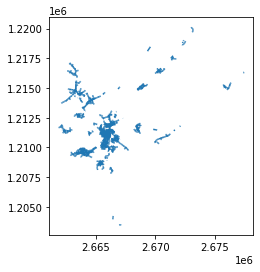

In [11]:
gdf.loc[gdf["T1024 Integration R500 metric"] > 120].plot()

In [12]:
# Limit to values higher then 120 and transform to WGS84
gdf_tmp = gdf.loc[gdf["T1024 Integration R500 metric"] > 150].set_crs("EPSG:2056")
#gdf_tmp["geometry"] = gdf_tmp["geometry"].apply(lambda r: r.buffer(50))
gdf_proj = gdf
_tmp.to_crs("EPSG:4326")
gdf_proj.head()

,T1024 Integration R500 metric,T1024 Choice R500 metric,geometry
10271,151.66942,8094,"LINESTRING (8.29525 47.02366, 8.29564 47.02408)"
10546,150.11342,16582,"LINESTRING (8.31068 47.02105, 8.31072 47.02099)"
10639,151.34201,16320,"LINESTRING (8.31055 47.02126, 8.31068 47.02105)"
10682,150.34972,19852,"LINESTRING (8.31047 47.02141, 8.31055 47.02126)"
11176,156.64296,9113,"LINESTRING (8.29564 47.02408, 8.29587 47.02427)"


In [13]:
preview_map = folium.Map(
    location = [47.05465, 8.30591], 
    zoom_start = 12,
    tiles='https://api.mapbox.com/styles/v1/gemeindescan/ckc4sha4310d21iszp8ri17u2/tiles/256/{z}/{x}/{y}@2x?access_token=%s' % (mapbox_token),
    attr='Mapbox, cividi'
)

folium.Choropleth(
    gdf_proj,
    line_weight=2,
    line_color='red'
).add_to(preview_map)


preview_map

## 3. Save results as GeoJSON

In [120]:
gdf_proj.to_file("data/lucerne.geojson", driver="GeoJSON")